In [1]:
import os
import librosa
import numpy as np
import soundfile
import IPython
import shutil
import pandas as pd

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import TensorDataset, DataLoader

from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_percentage_error
from sklearn.model_selection import train_test_split

import matplotlib.pyplot as plt
import cv2
from imutils import paths
from tqdm import tqdm

from tensorflow.keras.models import model_from_json
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

import warnings
warnings.filterwarnings("ignore")

2025-05-15 11:02:53.230983: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1747306973.641534      31 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1747306973.770738      31 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [2]:
import os
import shutil
import subprocess

def download_and_extract_librispeech(destination_folder="/kaggle/working"):
    librispeech_url = "http://openslr.elda.org/resources/12/dev-clean.tar.gz"
    librispeech_tar = os.path.join(destination_folder, "dev-clean.tar.gz")
    clean_speech_folder = os.path.join(destination_folder, "clean_speech")

    subprocess.run(["wget", librispeech_url, "-O", librispeech_tar])
    subprocess.run(["tar", "-xvf", librispeech_tar, "-C", destination_folder])
    
    os.makedirs(clean_speech_folder, exist_ok=True)

    for root, _, files in os.walk(os.path.join(destination_folder, "LibriSpeech/dev-clean")):
        for file in files:
            if file.endswith(".flac"):
                src = os.path.join(root, file)
                dest = os.path.join(clean_speech_folder, file)
                shutil.copy2(src, dest)

    shutil.rmtree(os.path.join(destination_folder, "LibriSpeech"))

    print(f"Clean speech files saved to {clean_speech_folder}")


def download_and_extract_esc50(destination_folder="/kaggle/working"):
    esc50_url = "https://codeload.github.com/karolpiczak/ESC-50/zip/refs/heads/master"
    esc50_zip = os.path.join(destination_folder, "ESC-50-master.zip")
    noise_folder = os.path.join(destination_folder, "noise")

    subprocess.run(["wget", esc50_url, "-O", esc50_zip])
    subprocess.run(["unzip", esc50_zip, "-d", destination_folder])

    os.makedirs(noise_folder, exist_ok=True)

    for root, _, files in os.walk(os.path.join(destination_folder, "ESC-50-master/audio")):
        for file in files:
            if file.endswith(".wav"):
                src = os.path.join(root, file)
                dest = os.path.join(noise_folder, file)
                shutil.copy2(src, dest)

    shutil.rmtree(os.path.join(destination_folder, "ESC-50-master"))

    print(f"Noise files saved to {noise_folder}")

download_and_extract_librispeech()
download_and_extract_esc50()

--2025-05-15 11:03:27--  http://openslr.elda.org/resources/12/dev-clean.tar.gz
Resolving openslr.elda.org (openslr.elda.org)... 141.94.109.138, 2001:41d0:203:ad8a::
Connecting to openslr.elda.org (openslr.elda.org)|141.94.109.138|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 337926286 (322M) [application/x-gzip]
Saving to: ‘/kaggle/working/dev-clean.tar.gz’

     0K .......... .......... .......... .......... ..........  0%  239K 23m0s
    50K .......... .......... .......... .......... ..........  0%  479K 17m14s
   100K .......... .......... .......... .......... ..........  0% 56.2M 11m31s
   150K .......... .......... .......... .......... ..........  0%  482K 11m29s
   200K .......... .......... .......... .......... ..........  0% 99.6M 9m12s
   250K .......... .......... .......... .......... ..........  0% 65.8M 7m41s
   300K .......... .......... .......... .......... ..........  0%  101M 6m35s
   350K .......... .......... .......... .......... ....

LibriSpeech/LICENSE.TXT
LibriSpeech/README.TXT
LibriSpeech/CHAPTERS.TXT
LibriSpeech/SPEAKERS.TXT
LibriSpeech/BOOKS.TXT
LibriSpeech/dev-clean/
LibriSpeech/dev-clean/2277/
LibriSpeech/dev-clean/2277/149896/
LibriSpeech/dev-clean/2277/149896/2277-149896-0026.flac
LibriSpeech/dev-clean/2277/149896/2277-149896-0005.flac
LibriSpeech/dev-clean/2277/149896/2277-149896-0033.flac
LibriSpeech/dev-clean/2277/149896/2277-149896-0006.flac
LibriSpeech/dev-clean/2277/149896/2277-149896-0018.flac
LibriSpeech/dev-clean/2277/149896/2277-149896-0034.flac
LibriSpeech/dev-clean/2277/149896/2277-149896-0021.flac
LibriSpeech/dev-clean/2277/149896/2277-149896-0015.flac
LibriSpeech/dev-clean/2277/149896/2277-149896-0012.flac
LibriSpeech/dev-clean/2277/149896/2277-149896-0027.flac
LibriSpeech/dev-clean/2277/149896/2277-149896-0007.flac
LibriSpeech/dev-clean/2277/149896/2277-149896-0030.flac
LibriSpeech/dev-clean/2277/149896/2277-149896-0011.flac
LibriSpeech/dev-clean/2277/149896/2277-149896-0009.flac
LibriSpeech

--2025-05-15 11:03:45--  https://codeload.github.com/karolpiczak/ESC-50/zip/refs/heads/master
Resolving codeload.github.com (codeload.github.com)... 140.82.112.10
Connecting to codeload.github.com (codeload.github.com)|140.82.112.10|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [application/zip]
Saving to: ‘/kaggle/working/ESC-50-master.zip’

     0K .......... .......... .......... .......... .......... 1019K
    50K .......... .......... .......... .......... .......... 1.99M
   100K .......... .......... .......... .......... .......... 59.1M
   150K .......... .......... .......... .......... .......... 2.05M
   200K .......... .......... .......... .......... .......... 60.4M
   250K .......... .......... .......... .......... .......... 60.8M
   300K .......... .......... .......... .......... .......... 95.1M
   350K .......... .......... .......... .......... .......... 2.20M
   400K .......... .......... .......... .......... .......... 

Archive:  /kaggle/working/ESC-50-master.zip
33c8ce9eb2cf0b1c2f8bcf322eb349b6be34dbb6
   creating: /kaggle/working/ESC-50-master/
   creating: /kaggle/working/ESC-50-master/.circleci/
  inflating: /kaggle/working/ESC-50-master/.circleci/config.yml  
   creating: /kaggle/working/ESC-50-master/.github/
  inflating: /kaggle/working/ESC-50-master/.github/stale.yml  
 extracting: /kaggle/working/ESC-50-master/.gitignore  
  inflating: /kaggle/working/ESC-50-master/LICENSE  
  inflating: /kaggle/working/ESC-50-master/README.md  
   creating: /kaggle/working/ESC-50-master/audio/
  inflating: /kaggle/working/ESC-50-master/audio/1-100032-A-0.wav  
  inflating: /kaggle/working/ESC-50-master/audio/1-100038-A-14.wav  
  inflating: /kaggle/working/ESC-50-master/audio/1-100210-A-36.wav  
  inflating: /kaggle/working/ESC-50-master/audio/1-100210-B-36.wav  
  inflating: /kaggle/working/ESC-50-master/audio/1-101296-A-19.wav  
  inflating: /kaggle/working/ESC-50-master/audio/1-101296-B-19.wav  
  inflati

In [3]:
count_clean = 0
duration_clean = 0
duration_noise = 0
sample_rate=8000

for i in os.listdir('/kaggle/working/clean_speech'):
  count_clean += 1
  y,sr = librosa.load(os.path.join('/kaggle/working/clean_speech',i),sr=sample_rate)
  duration = librosa.get_duration(y=y,sr=sr)
  duration_clean+=duration

print(f'Number of clean audio files are {count_clean}')
print(f'Total duration of all clean audios {duration_clean//60}')

count_noise = 0
for i in os.listdir('/kaggle/working/noise'):
  count_noise += 1
  y,sr = librosa.load(os.path.join('/kaggle/working/noise',i),sr=sample_rate)
  duration = librosa.get_duration(y=y,sr=sr)
  duration_noise+=duration

print(f'Number of Noisy audio files are {count_noise}')
print(f'Total duration of all noise audios {duration_noise//60}')

Number of clean audio files are 2703
Total duration of all clean audios 323.0
Number of Noisy audio files are 2000
Total duration of all noise audios 166.0


In [4]:
def audio_to_audio_frame_stack(sound_data, frame_length, hop_length_frame):
    sequence_sample_length = sound_data.shape[0]
    sound_data_list = [sound_data[start:start + frame_length] for start in range(
    0, sequence_sample_length - frame_length + 1, hop_length_frame)]
    sound_data_array = np.vstack(sound_data_list)
    return sound_data_array

In [5]:
noise_dir="/kaggle/working/noise/"
voice_dir="/kaggle/working/clean_speech/"
path_save_spectrogram="/kaggle/working/spectogram/"
sample_rate=8000
min_duration=5.0
frame_length=8064
hop_length_frame=8064
hop_length_frame_noise=5000
nb_samples=500
n_fft=255
hop_length_fft=63
dim_square_spec = int(n_fft / 2) + 1

In [6]:
clean_audio_files = os.listdir(voice_dir)
clean_random_audio = np.random.choice(clean_audio_files)
y,sr = librosa.load(os.path.join(voice_dir,clean_random_audio),sr=sample_rate)
clean = audio_to_audio_frame_stack(y,frame_length,hop_length_frame)
print("Clean Audio: {}".format(clean_random_audio))
print("Shape:{}".format(clean.shape))

Clean Audio: 3170-137482-0030.flac
Shape:(6, 8064)


In [7]:
noisy_audio_files = os.listdir(noise_dir)
noisy_random_audio = np.random.choice(noisy_audio_files)
y,sr = librosa.load(os.path.join(noise_dir,noisy_random_audio),sr=sample_rate)
noise = audio_to_audio_frame_stack(y,frame_length,hop_length_frame)
print("Noise Audio: {}".format(noisy_random_audio))
print("Shape:{}".format(noise.shape))

Noise Audio: 1-27403-A-28.wav
Shape:(4, 8064)


In [8]:
clean = np.vstack(clean)
noise = np.vstack(noise)

In [9]:
def blend_noise_randomly(voice, noise, nb_samples, frame_length):
    """This function takes as input numpy arrays representing frames
    of voice sounds, noise sounds and the number of frames to be created
    and return numpy arrays with voice randomly blend with noise"""

    prod_voice = np.zeros((nb_samples, frame_length))
    prod_noise = np.zeros((nb_samples, frame_length))
    prod_noisy_voice = np.zeros((nb_samples, frame_length))

    for i in range(nb_samples):
        id_voice = np.random.randint(0, voice.shape[0])
        id_noise = np.random.randint(0, noise.shape[0])
        level_noise = np.random.uniform(0.2, 0.8)
        prod_voice[i, :] = voice[id_voice, :]
        prod_noise[i, :] = level_noise * noise[id_noise, :]
        prod_noisy_voice[i, :] = prod_voice[i, :] + prod_noise[i, :]

    return prod_voice, prod_noise, prod_noisy_voice

In [10]:
prod_voice, prod_noise, prod_noisy_voice = blend_noise_randomly(voice=clean,noise=noise,nb_samples=10,frame_length=frame_length)
prod_voice.shape

(10, 8064)

In [11]:
samples_clean = []
samples_noisy_clean = []
for x in prod_voice:
  samples_clean.extend(x)

for x in prod_noisy_voice:
  samples_noisy_clean.extend(x)

80640
80640


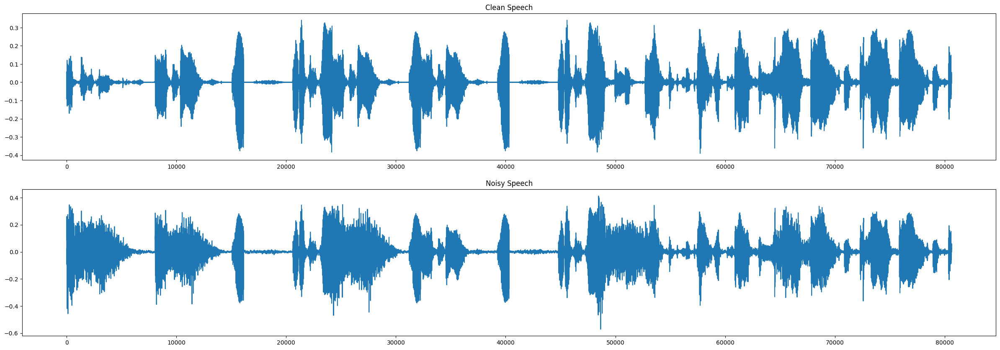

In [12]:
print(len(samples_clean))
print(len(samples_noisy_clean))

import matplotlib.pyplot as plt
plt.figure(figsize=(30,10))
plt.subplot(211)
plt.title("Clean Speech")
plt.plot(samples_clean)

plt.subplot(212)
plt.title("Noisy Speech")
plt.plot(samples_noisy_clean)

plt.show()

In [13]:
import soundfile as sf
clean_nb_samples = prod_voice.shape[0]
clean_long = prod_voice.reshape(1, 10 * frame_length)*10
sf.write("clean_long.wav", clean_long[0,:], 8000, 'PCM_24')

from IPython.display import Audio
Audio('clean_long.wav')

In [14]:
noise_nb_samples = prod_noisy_voice.shape[0]
noise_long = prod_noisy_voice.reshape(1, 10 * frame_length)*10
sf.write("noise_long.wav", noise_long[0,:], 8000, 'PCM_24')

from IPython.display import Audio
Audio('noise_long.wav')

# Data preparation

In [15]:
import os
import random
import numpy as np
import librosa

import torch
from torch.utils.data import Dataset, DataLoader

def list_audio_files(folder, exts=(".wav", ".flac")):
    return [os.path.join(folder, f)
            for f in os.listdir(folder)
            if f.lower().endswith(exts)]

def frame_audio(y, frame_length, hop_length):
    # (n_frames, frame_length)
    n_frames = 1 + (len(y) - frame_length) // hop_length
    return np.stack([
        y[i*hop_length : i*hop_length + frame_length]
        for i in range(n_frames)
    ], axis=0)

def compute_mag_spectrogram(frame, n_fft, hop_length):
    # 1D frame -> (freq_bins, time_steps)
    S = librosa.stft(frame, n_fft=n_fft, hop_length=hop_length, center=False)
    return np.abs(S)

def pad_to_multiple(spec: np.ndarray, mult=8) -> np.ndarray:
     """
     Pads 2D array `spec` at bottom/right so that 
     both dimensions become multiples of `mult`.
     Padding is done with reflect to avoid edge artifacts.
     """
     F, T = spec.shape
     pad_F = (mult - (F % mult)) % mult
     pad_T = (mult - (T % mult)) % mult
     if pad_F or pad_T:
         spec = np.pad(
             spec,
             ((0, pad_F), (0, pad_T)),
             mode="reflect"
         )
     return spec

class AudioDenoiseDataset(Dataset):
    def __init__(self,
                 clean_folder,
                 noise_folder,
                 sample_rate=8000,
                 frame_length=8064,
                 hop_length_frame=8064,
                 n_fft=255,
                 hop_length_fft=63,
                 nb_samples=1000,
                 noise_levels=(0.2,0.8)):
        super().__init__()
        self.clean_files = list_audio_files(clean_folder)
        self.noise_files = list_audio_files(noise_folder)
        self.sr = sample_rate
        self.frame_len = frame_length
        self.hop_len_frame = hop_length_frame
        self.n_fft = n_fft
        self.hop_fft = hop_length_fft
        self.nb_samples = nb_samples
        self.noise_levels = noise_levels

    def __len__(self):
        return self.nb_samples

    def __getitem__(self, idx):
        clean_path = random.choice(self.clean_files)
        noise_path = random.choice(self.noise_files)

        clean_y, _ = librosa.load(clean_path, sr=self.sr)
        noise_y, _ = librosa.load(noise_path, sr=self.sr)

        clean_frames = frame_audio(clean_y, self.frame_len, self.hop_len_frame)
        noise_frames = frame_audio(noise_y, self.frame_len, self.hop_len_frame)

        c = clean_frames[np.random.randint(len(clean_frames))]
        n = noise_frames[np.random.randint(len(noise_frames))]

        level = np.random.uniform(*self.noise_levels)
        noisy = c + level * n

        spec_c = compute_mag_spectrogram(c, self.n_fft, self.hop_fft)
        spec_n = compute_mag_spectrogram(noisy, self.n_fft, self.hop_fft)

        def norm(x):
            x = np.log1p(x)
            x = x / np.max(np.abs(x))
            return x.astype(np.float32)
        spec_c = norm(spec_c)
        spec_n = norm(spec_n)

        def pad_to_multiple(spec, mult=8):
            F, T = spec.shape
            pad_F = (mult - (F % mult)) % mult
            pad_T = (mult - (T % mult)) % mult
            if pad_F or pad_T:
                spec = np.pad(spec,
                              ((0, pad_F), (0, pad_T)),
                              mode="reflect")
            return spec

        spec_c = pad_to_multiple(spec_c, mult=8)
        spec_n = pad_to_multiple(spec_n, mult=8)

        return (
            torch.from_numpy(spec_n)[None, ...],
            torch.from_numpy(spec_c)[None, ...],
            noisy.astype(np.float32),
            c.astype(np.float32),
        )


In [16]:
clean_dir = "/kaggle/working/clean_speech"
noise_dir = "/kaggle/working/noise"

dataset = AudioDenoiseDataset(
    clean_folder=clean_dir,
    noise_folder=noise_dir,
    sample_rate=8000,
    frame_length=8064,
    hop_length_frame=8000,
    n_fft=255,
    hop_length_fft=63,
    nb_samples=5000,
    noise_levels=(0.2, 0.8),
)
loader = DataLoader(dataset, batch_size=16, shuffle=True, num_workers=4)

# iterate once to check shapes
noisy_batch, clean_batch, noisy_wave_batch, clean_wave_batch = next(iter(loader))
print("Noisy spectrogram batch:", noisy_batch.shape)
print("Clean spectrogram batch:", clean_batch.shape)

Noisy spectrogram batch: torch.Size([16, 1, 128, 128])
Clean spectrogram batch: torch.Size([16, 1, 128, 128])


In [17]:
noisy_spec, clean_spec, noisy_wave, clean_wave = next(iter(loader))

noisy_wav = noisy_wave[0].numpy()
clean_wav = clean_wave[0].numpy()

import soundfile as sf
sf.write("clean_sample.wav", clean_wav, 8000)
sf.write("noisy_sample.wav", noisy_wav, 8000)

from IPython.display import Audio, display
print("Clean sample:")
display(Audio("clean_sample.wav", rate=8000))
print("Noisy sample:")
display(Audio("noisy_sample.wav", rate=8000))


Clean sample:


Noisy sample:


In [18]:
import torch
import torch.nn as nn
import torch.nn.functional as F


class SelfAttention(nn.Module):
    def __init__(self, in_dim):
        super().__init__()
        self.query_conv = nn.Conv2d(in_dim, in_dim // 8, kernel_size=1)
        self.key_conv   = nn.Conv2d(in_dim, in_dim // 8, kernel_size=1)
        self.value_conv = nn.Conv2d(in_dim, in_dim,     kernel_size=1)
        self.gamma      = nn.Parameter(torch.zeros(1))

    def forward(self, x):
        batch, C, H, W = x.size()
        proj_query = self.query_conv(x).view(batch, -1, H*W).permute(0, 2, 1) 
        proj_key   = self.key_conv(x).view(batch, -1, H*W) 
        energy     = torch.bmm(proj_query, proj_key)  
        attention  = F.softmax(energy, dim=-1)
        proj_value = self.value_conv(x).view(batch, -1, H*W)

        out = torch.bmm(proj_value, attention.permute(0, 2, 1))
        out = out.view(batch, C, H, W)
        return self.gamma * out + x


class DenseBlock(nn.Module):
    def __init__(self, in_channels, growth_rate, num_layers):
        super().__init__()
        self.layers = nn.ModuleList()
        for i in range(num_layers):
            self.layers.append(
                nn.Sequential(
                    nn.BatchNorm2d(in_channels + i * growth_rate),
                    nn.ReLU(inplace=True),
                    nn.Conv2d(in_channels + i * growth_rate, growth_rate, kernel_size=3, padding=1)
                )
            )

    def forward(self, x):
        features = [x]
        for layer in self.layers:
            out = layer(torch.cat(features, 1))
            features.append(out)
        return torch.cat(features, 1)


class TFDenseUNetGenerator(nn.Module):
    def __init__(self, in_channels=1, base_channels=32, growth_rate=16, num_layers=4):
        super().__init__()
        # Encoder
        self.enc1 = DenseBlock(in_channels, growth_rate, num_layers)
        enc1_out = in_channels + num_layers * growth_rate
        self.down1 = nn.Conv2d(enc1_out, base_channels, kernel_size=4, stride=2, padding=1)

        self.enc2 = DenseBlock(base_channels, growth_rate, num_layers)
        enc2_out = base_channels + num_layers * growth_rate
        self.down2 = nn.Conv2d(enc2_out, base_channels*2, kernel_size=4, stride=2, padding=1)

        self.enc3 = DenseBlock(base_channels*2, growth_rate, num_layers)
        enc3_out = base_channels*2 + num_layers * growth_rate
        self.down3 = nn.Conv2d(enc3_out, base_channels*4, kernel_size=4, stride=2, padding=1)

        self.bottleneck = DenseBlock(base_channels*4, growth_rate, num_layers)
        bottleneck_out = base_channels*4 + num_layers * growth_rate
        self.attn = SelfAttention(bottleneck_out)

        self.up3 = nn.ConvTranspose2d(bottleneck_out, base_channels*2, kernel_size=4, stride=2, padding=1)
        dec3_in = base_channels*2 + enc3_out
        self.dec3 = DenseBlock(dec3_in, growth_rate, num_layers)
        dec3_out = dec3_in + num_layers * growth_rate

        self.up2 = nn.ConvTranspose2d(dec3_out, base_channels, kernel_size=4, stride=2, padding=1)
        dec2_in = base_channels + enc2_out
        self.dec2 = DenseBlock(dec2_in, growth_rate, num_layers)
        dec2_out = dec2_in + num_layers * growth_rate

        self.up1 = nn.ConvTranspose2d(dec2_out, base_channels, kernel_size=4, stride=2, padding=1)
        dec1_in = base_channels + enc1_out
        self.dec1 = DenseBlock(dec1_in, growth_rate, num_layers)
        dec1_out = dec1_in + num_layers * growth_rate

        self.final_conv = nn.Conv2d(dec1_out, in_channels, kernel_size=1)

    def forward(self, x):
        e1 = self.enc1(x)
        d1 = self.down1(e1)

        e2 = self.enc2(d1)
        d2 = self.down2(e2)

        e3 = self.enc3(d2)
        d3 = self.down3(e3)

        b = self.bottleneck(d3)
        b = self.attn(b)

        u3 = self.up3(b)
        cat3 = torch.cat([u3, e3], dim=1)
        dec3 = self.dec3(cat3)

        u2 = self.up2(dec3)
        cat2 = torch.cat([u2, e2], dim=1)
        dec2 = self.dec2(cat2)

        u1 = self.up1(dec2)
        cat1 = torch.cat([u1, e1], dim=1)
        dec1 = self.dec1(cat1)

        out = self.final_conv(dec1)
        return out


class PatchGANDiscriminator(nn.Module):
    def __init__(self, in_channels=1, base_channels=64):
        super().__init__()
        layers = []
        layers.append(nn.Conv2d(in_channels, base_channels, kernel_size=4, stride=2, padding=1))
        layers.append(nn.LeakyReLU(0.2, inplace=True))
        ch = base_channels
        for i in range(1, 5):
            layers.append(nn.Conv2d(ch, ch*2, kernel_size=4, stride=2, padding=1))
            layers.append(nn.InstanceNorm2d(ch*2))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            ch *= 2
        layers.append(nn.Conv2d(ch, 1, kernel_size=4, padding=1))
        self.model = nn.Sequential(*layers)

    def forward(self, x):
        return self.model(x)


class MultiScaleDiscriminator(nn.Module):
    def __init__(self, num_scales=3):
        super().__init__()
        self.discriminators = nn.ModuleList([
            PatchGANDiscriminator() for _ in range(num_scales)
        ])
        self.downsample = nn.AvgPool2d(3, stride=2, padding=[1,1], count_include_pad=False)

    def forward(self, x):
        results = []
        for D in self.discriminators:
            results.append(D(x))
            x = self.downsample(x)
        return results

In [19]:
!pip install pesq
!pip install pystoi

  Preparing metadata (setup.py) ... done
  Created wheel for pesq: filename=pesq-0.0.4-cp311-cp311-linux_x86_64.whl size=275939 sha256=7f1c7d062e427d1b68d32ec832d2f843f579ffe731116ca314aabc197937231d
  Stored in directory: /root/.cache/pip/wheels/ae/f1/23/2698d0bf31eec2b2aa50623b5d93b6206c49c7155d0e31345d
Successfully built pesq


In [20]:
import torch
import torch.nn as nn
from torch.utils.data import DataLoader
from tqdm import tqdm
import numpy as np
import os
import json
import matplotlib.pyplot as plt
from pesq import pesq
from skimage.metrics import structural_similarity as ssim, peak_signal_noise_ratio as psnr

def compute_inverse_mag_spectrogram(mag_spec, phase, n_fft, hop_length):
    stft_matrix = mag_spec * np.exp(1j * phase)
    return librosa.istft(stft_matrix, hop_length=hop_length, center=False)

def train(
    generator, discriminator, 
    train_dataset, val_dataset,
    num_epochs=50, batch_size=16, 
    lr=2e-4, device="cuda",
    save_dir="checkpoints"
):

    os.makedirs(save_dir, exist_ok=True)

    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4)
    val_loader = DataLoader(val_dataset, batch_size=1, shuffle=False, num_workers=2)
    
    g_opt = torch.optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))
    d_opt = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.999))
    
    l1_loss = nn.L1Loss().to(device)
    best_pesq = -np.inf
    history = {"train_mae": [], "train_psnr": [], "train_ssim": [], "val_pesq": []}
    
    for epoch in range(1, num_epochs+1):
        generator.train()
        discriminator.train()
        epoch_mae, epoch_psnr, epoch_ssim = 0.0, 0.0, 0.0
        prog = tqdm(train_loader, desc=f"Epoch {epoch}/{num_epochs}")
        
        for noisy_spec, clean_spec, noisy_wav, clean_wav in prog:
            noisy_spec = noisy_spec.to(device)
            clean_spec = clean_spec.to(device)
            noisy_wav = noisy_wav.to(device)
            clean_wav = clean_wav.to(device)

            fake_clean = generator(noisy_spec)
            mae = l1_loss(fake_clean, clean_spec)
            
            g_opt.zero_grad()
            mae.backward()
            g_opt.step()
            
            fake_np = fake_clean.detach().cpu().numpy()[0,0]
            clean_np = clean_spec.detach().cpu().numpy()[0,0]
            epoch_mae += mae.item()
            epoch_psnr += psnr(clean_np, fake_np, data_range=fake_np.max()-fake_np.min())
            epoch_ssim += ssim(clean_np, fake_np, data_range=fake_np.max()-fake_np.min())

            prog.set_postfix({
                "MAE": epoch_mae / (prog.n+1),
                "PSNR": epoch_psnr / (prog.n+1),
                "SSIM": epoch_ssim / (prog.n+1)
            })

        history["train_mae"].append(epoch_mae / len(train_loader))
        history["train_psnr"].append(epoch_psnr / len(train_loader))
        history["train_ssim"].append(epoch_ssim / len(train_loader))

        generator.eval()
        val_pesq_total = 0.0
        valid_count = 0
        with torch.no_grad():
            for noisy_spec, clean_spec, noisy_wav, clean_wav in val_loader:
                noisy_spec = noisy_spec.to(device)
                denoised_spec = generator(noisy_spec).cpu().numpy()[0,0]

                frame_length = 8064
                n_fft = 255
                hop_length_fft = 63
                
                T_original = (frame_length - n_fft) // hop_length_fft + 1
                denoised_spec = denoised_spec[:, :T_original]
                
                noisy_wav = noisy_wav.squeeze().numpy()
                clean_wav = clean_wav.squeeze().numpy()
                _, phase = librosa.magphase(librosa.stft(
                    noisy_wav, 
                    n_fft=n_fft, 
                    hop_length=hop_length_fft,
                    center=False
                ))
                
                denoised_wav = librosa.istft(
                    denoised_spec * phase,
                    hop_length=hop_length_fft,
                    center=False
                )
            
                min_len = min(len(clean_wav), len(denoised_wav))
                clean_wav = clean_wav[:min_len]
                denoised_wav = denoised_wav[:min_len]
  
                if min_len < 160:
                    continue
                    
                if np.allclose(clean_wav, 0) or np.allclose(denoised_wav, 0):
                    continue
                    
                clean_wav = clean_wav / np.max(np.abs(clean_wav))
                denoised_wav = denoised_wav / np.max(np.abs(denoised_wav))
                
                try:
                    p = pesq(8000, clean_wav, denoised_wav, 'nb')
                    val_pesq_total += p
                    valid_count += 1
                except:
                    print("PESQ computation failed for this sample")
                    continue
        
        val_pesq = val_pesq_total / valid_count if valid_count > 0 else 0
        history["val_pesq"].append(val_pesq)
        print(f"Epoch {epoch}: current PESQ = {val_pesq:.4f}, best = {best_pesq:.4f}")
        if val_pesq > best_pesq:
            best_pesq = val_pesq
            print("Saved the best model")
            torch.save({
                "epoch": epoch,
                "generator_state": generator.state_dict(),
                "discriminator_state": discriminator.state_dict(),
                "optimizer_g": g_opt.state_dict(),
                "optimizer_d": d_opt.state_dict(),
                "best_pesq": best_pesq,
                "history": history
            }, os.path.join(save_dir, "best_model.pth"))
            with open(os.path.join(save_dir, "best_history.json"), "w") as f:
                json.dump(history, f, indent=2)

    epochs = range(1, num_epochs+1)
    plt.figure()
    plt.plot(epochs, history["train_mae"], label="Train MAE")
    plt.plot(epochs, history["train_psnr"], label="Train PSNR")
    plt.plot(epochs, history["train_ssim"], label="Train SSIM")
    plt.xlabel("Epoch")
    plt.legend()
    plt.title("Training Metrics")
    plt.show()

    plt.figure()
    plt.plot(epochs, history["val_pesq"], label="Val PESQ")
    plt.xlabel("Epoch")
    plt.legend()
    plt.title("Validation PESQ")
    plt.show()

    return history

In [21]:
SAVE_ROOT = "/kaggle/working/checkpoints"
os.makedirs(SAVE_ROOT, exist_ok=True)

# OPTIMIZED MODEL

Using 2 GPUs with DataParallel


Epoch 1/10: 100%|██████████| 2500/2500 [07:54<00:00,  5.26it/s, MAE=0.0272, PSNR=27.3, SSIM=0.67] 


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 2/10: 100%|██████████| 2500/2500 [07:53<00:00,  5.28it/s, MAE=0.0194, PSNR=29.5, SSIM=0.767]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 3/10: 100%|██████████| 2500/2500 [07:54<00:00,  5.27it/s, MAE=0.0167, PSNR=30.5, SSIM=0.8]  


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 4/10: 100%|██████████| 2500/2500 [07:57<00:00,  5.24it/s, MAE=0.0152, PSNR=31.6, SSIM=0.825]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 5/10: 100%|██████████| 2500/2500 [07:51<00:00,  5.30it/s, MAE=0.014, PSNR=32, SSIM=0.838]   


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 6/10: 100%|██████████| 2500/2500 [07:56<00:00,  5.25it/s, MAE=0.0132, PSNR=32.8, SSIM=0.85] 


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 6: current PESQ = 1.8011, best = 1.7897
Saved the best model


Epoch 7/10: 100%|██████████| 2500/2500 [07:53<00:00,  5.28it/s, MAE=0.0125, PSNR=33.2, SSIM=0.857]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 8/10: 100%|██████████| 2500/2500 [07:49<00:00,  5.33it/s, MAE=0.012, PSNR=33.7, SSIM=0.864] 


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 9/10: 100%|██████████| 2500/2500 [07:51<00:00,  5.31it/s, MAE=0.0115, PSNR=34.2, SSIM=0.869]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 10/10: 100%|██████████| 2500/2500 [07:50<00:00,  5.31it/s, MAE=0.0112, PSNR=34.4, SSIM=0.872]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


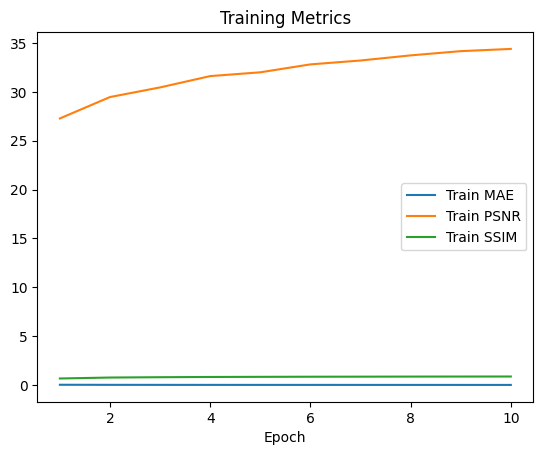

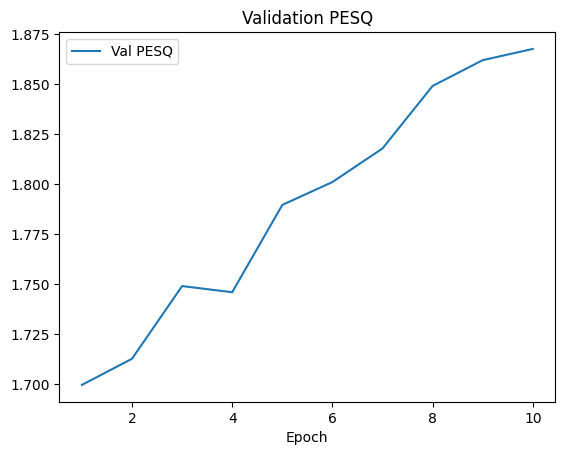

Training completed in 8612.08 seconds.


In [23]:
from torch.utils.data import Subset, DataLoader
import numpy as np
import torch
import torch.nn as nn
import time

full_dataset = AudioDenoiseDataset(
    clean_folder=clean_dir,
    noise_folder=noise_dir,
    sample_rate=8000,
    frame_length=8064,
    hop_length_frame=8000,
    n_fft=255,
    hop_length_fft=63,
    nb_samples=50000,
    noise_levels=(0.2, 0.8),
)


num_total = len(full_dataset)
indices = np.arange(num_total)
np.random.shuffle(indices)

train_ratio = 0.8
num_train = int(train_ratio * num_total)
train_idx, val_idx = indices[:num_train], indices[num_train:]

train_dataset = Subset(full_dataset, train_idx)
val_dataset   = Subset(full_dataset, val_idx)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=4)
val_loader   = DataLoader(val_dataset,   batch_size=1,  shuffle=False, num_workers=2)


generator = TFDenseUNetGenerator()
discriminator = MultiScaleDiscriminator()

if torch.cuda.is_available() and torch.cuda.device_count() > 1:
    print(f"Using {torch.cuda.device_count()} GPUs with DataParallel")
    generator = nn.DataParallel(generator)
    discriminator = nn.DataParallel(discriminator)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator.to(device)
discriminator.to(device)


start_time = time.time()

history = train(
    generator, discriminator,
    train_dataset, val_dataset,
    num_epochs=10,
    batch_size=16,
    lr=1e-4,
    device=device,
    save_dir=SAVE_ROOT
)

end_time = time.time()

elapsed_time = end_time - start_time
print(f"Training completed in {elapsed_time:.2f} seconds.")

Using 2 GPUs with DataParallel


Epoch 1/10: 100%|██████████| 250/250 [00:47<00:00,  5.29it/s, MAE=0.044, PSNR=25, SSIM=0.511]   


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 1: current PESQ = 1.4805, best = -inf
Saved the best model


Epoch 2/10: 100%|██████████| 250/250 [00:47<00:00,  5.30it/s, MAE=0.0336, PSNR=26.3, SSIM=0.582]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 2: current PESQ = 1.5569, best = 1.4805
Saved the best model


Epoch 3/10: 100%|██████████| 250/250 [00:46<00:00,  5.35it/s, MAE=0.0312, PSNR=26.8, SSIM=0.617]


PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 3: current PESQ = 1.5584, best = 1.5569
Saved the best model


Epoch 4/10: 100%|██████████| 250/250 [00:47<00:00,  5.28it/s, MAE=0.0276, PSNR=26.7, SSIM=0.631]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 4: current PESQ = 1.6183, best = 1.5584
Saved the best model


Epoch 5/10: 100%|██████████| 250/250 [00:47<00:00,  5.30it/s, MAE=0.026, PSNR=27.3, SSIM=0.66]  


PESQ computation failed for this sample
Epoch 5: current PESQ = 1.6771, best = 1.6183
Saved the best model


Epoch 6/10: 100%|██████████| 250/250 [00:47<00:00,  5.25it/s, MAE=0.0249, PSNR=27.6, SSIM=0.671]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 6: current PESQ = 1.6057, best = 1.6771


Epoch 7/10: 100%|██████████| 250/250 [00:47<00:00,  5.24it/s, MAE=0.0243, PSNR=27.8, SSIM=0.688]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 7: current PESQ = 1.5843, best = 1.6771


Epoch 8/10: 100%|██████████| 250/250 [00:47<00:00,  5.24it/s, MAE=0.0236, PSNR=28.4, SSIM=0.711]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 8: current PESQ = 1.5692, best = 1.6771


Epoch 9/10: 100%|██████████| 250/250 [00:46<00:00,  5.33it/s, MAE=0.0222, PSNR=28, SSIM=0.712]  


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 9: current PESQ = 1.6688, best = 1.6771


Epoch 10/10: 100%|██████████| 250/250 [00:47<00:00,  5.31it/s, MAE=0.0218, PSNR=28.7, SSIM=0.718]


PESQ computation failed for this sample
Epoch 10: current PESQ = 1.6917, best = 1.6771
Saved the best model


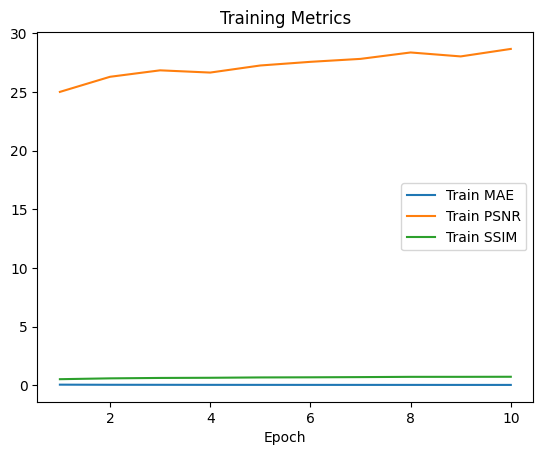

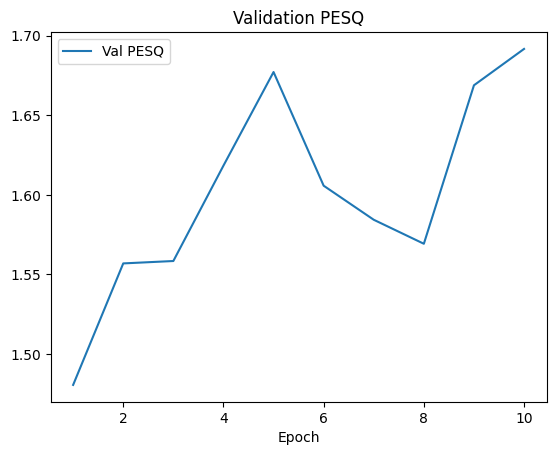

Training completed in 866.01 seconds.


In [23]:
from torch.utils.data import Subset, DataLoader
import numpy as np
import torch
import torch.nn as nn
import time

full_dataset = AudioDenoiseDataset(
    clean_folder=clean_dir,
    noise_folder=noise_dir,
    sample_rate=8000,
    frame_length=8064,
    hop_length_frame=8000,
    n_fft=255,
    hop_length_fft=63,
    nb_samples=5000,
    noise_levels=(0.2, 0.8),
)


num_total = len(full_dataset)
indices = np.arange(num_total)
np.random.shuffle(indices)

train_ratio = 0.8
num_train = int(train_ratio * num_total)
train_idx, val_idx = indices[:num_train], indices[num_train:]

train_dataset = Subset(full_dataset, train_idx)
val_dataset   = Subset(full_dataset, val_idx)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=4)
val_loader   = DataLoader(val_dataset,   batch_size=1,  shuffle=False, num_workers=2)


generator = TFDenseUNetGenerator()
discriminator = MultiScaleDiscriminator()

if torch.cuda.is_available() and torch.cuda.device_count() > 1:
    print(f"Using {torch.cuda.device_count()} GPUs with DataParallel")
    generator = nn.DataParallel(generator)
    discriminator = nn.DataParallel(discriminator)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator.to(device)
discriminator.to(device)


start_time = time.time()

history = train(
    generator, discriminator,
    train_dataset, val_dataset,
    num_epochs=10,
    batch_size=16,
    lr=1e-4,
    device=device,
    save_dir=SAVE_ROOT
)

end_time = time.time()

elapsed_time = end_time - start_time
print(f"Training completed in {elapsed_time:.2f} seconds.")

In [24]:
print("Saved files:", os.listdir(SAVE_ROOT))

Saved files: ['best_model.pth', 'best_history.json']


In [25]:
SAVE_ROOT = "/kaggle/working/checkpoints"
print("Saved files:", os.listdir(SAVE_ROOT))
!zip -r /kaggle/working/checkpoints.zip {SAVE_ROOT}
print("Zipped:", os.path.exists("/kaggle/working/checkpoints.zip"))

Saved files: ['best_model.pth', 'best_history.json']
  adding: kaggle/working/checkpoints/ (stored 0%)
  adding: kaggle/working/checkpoints/best_model.pth (deflated 8%)
  adding: kaggle/working/checkpoints/best_history.json (deflated 55%)
Zipped: True


# 20000 data 10 epochs

Using 2 GPUs with DataParallel


Epoch 1/10: 100%|██████████| 1000/1000 [03:07<00:00,  5.33it/s, MAE=0.0338, PSNR=26.1, SSIM=0.592]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 1: current PESQ = 1.5480, best = -inf
Saved the best model


Epoch 2/10: 100%|██████████| 1000/1000 [03:08<00:00,  5.31it/s, MAE=0.0246, PSNR=27.7, SSIM=0.691]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 2: current PESQ = 1.6169, best = 1.5480
Saved the best model


Epoch 3/10: 100%|██████████| 1000/1000 [03:07<00:00,  5.32it/s, MAE=0.0218, PSNR=28.4, SSIM=0.735]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 3: current PESQ = 1.6829, best = 1.6169
Saved the best model


Epoch 4/10: 100%|██████████| 1000/1000 [03:08<00:00,  5.32it/s, MAE=0.0199, PSNR=29, SSIM=0.757] 


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 4: current PESQ = 1.7241, best = 1.6829
Saved the best model


Epoch 5/10: 100%|██████████| 1000/1000 [03:08<00:00,  5.32it/s, MAE=0.0184, PSNR=29.7, SSIM=0.778]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 5: current PESQ = 1.7252, best = 1.7241
Saved the best model


Epoch 6/10: 100%|██████████| 1000/1000 [03:08<00:00,  5.31it/s, MAE=0.0175, PSNR=30, SSIM=0.792] 


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 6: current PESQ = 1.6979, best = 1.7252


Epoch 7/10: 100%|██████████| 1000/1000 [03:09<00:00,  5.28it/s, MAE=0.0165, PSNR=30.5, SSIM=0.811]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 7: current PESQ = 1.7511, best = 1.7252
Saved the best model


Epoch 8/10: 100%|██████████| 1000/1000 [03:08<00:00,  5.30it/s, MAE=0.0159, PSNR=31.1, SSIM=0.821]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 8: current PESQ = 1.7422, best = 1.7511


Epoch 9/10: 100%|██████████| 1000/1000 [03:09<00:00,  5.28it/s, MAE=0.0152, PSNR=31.2, SSIM=0.823]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 9: current PESQ = 1.7341, best = 1.7511


Epoch 10/10: 100%|██████████| 1000/1000 [03:07<00:00,  5.32it/s, MAE=0.0147, PSNR=31.5, SSIM=0.832]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 10: current PESQ = 1.7518, best = 1.7511
Saved the best model


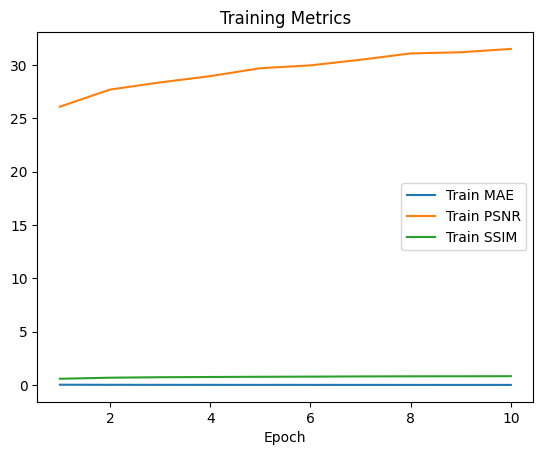

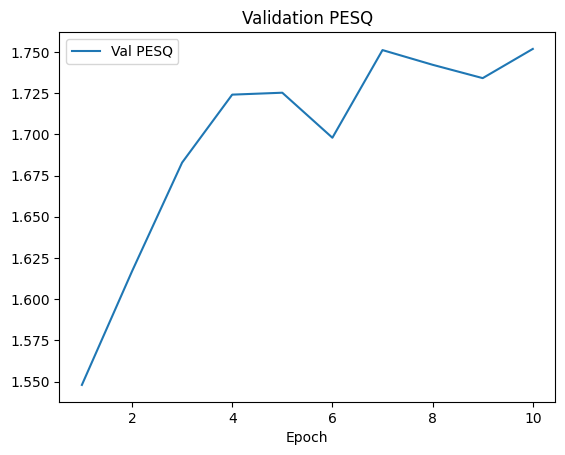

Training completed in 3454.20 seconds.


In [26]:
full_dataset = AudioDenoiseDataset(
    clean_folder=clean_dir,
    noise_folder=noise_dir,
    sample_rate=8000,
    frame_length=8064,
    hop_length_frame=8000,
    n_fft=255,
    hop_length_fft=63,
    nb_samples=20000,
    noise_levels=(0.2, 0.8),
)


num_total = len(full_dataset)
indices = np.arange(num_total)
np.random.shuffle(indices)

train_ratio = 0.8
num_train = int(train_ratio * num_total)
train_idx, val_idx = indices[:num_train], indices[num_train:]

train_dataset = Subset(full_dataset, train_idx)
val_dataset   = Subset(full_dataset, val_idx)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=4)
val_loader   = DataLoader(val_dataset,   batch_size=1,  shuffle=False, num_workers=2)


generator = TFDenseUNetGenerator()
discriminator = MultiScaleDiscriminator()

if torch.cuda.is_available() and torch.cuda.device_count() > 1:
    print(f"Using {torch.cuda.device_count()} GPUs with DataParallel")
    generator = nn.DataParallel(generator)
    discriminator = nn.DataParallel(discriminator)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator.to(device)
discriminator.to(device)


start_time = time.time()

history = train(
    generator, discriminator,
    train_dataset, val_dataset,
    num_epochs=10,
    batch_size=16,
    lr=1e-4,
    device=device,
    save_dir=SAVE_ROOT
)

end_time = time.time()

elapsed_time = end_time - start_time
print(f"Training completed in {elapsed_time:.2f} seconds.")

# 2000 data 5 epochs 16 batch size:

Using 2 GPUs with DataParallel


Epoch 1/5: 100%|██████████| 1000/1000 [03:07<00:00,  5.33it/s, MAE=0.0339, PSNR=25.8, SSIM=0.587]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 1: current PESQ = 1.5517, best = -inf
Saved the best model


Epoch 2/5: 100%|██████████| 1000/1000 [03:08<00:00,  5.31it/s, MAE=0.0246, PSNR=27.6, SSIM=0.695]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 2: current PESQ = 1.6745, best = 1.5517
Saved the best model


Epoch 3/5: 100%|██████████| 1000/1000 [03:07<00:00,  5.33it/s, MAE=0.0218, PSNR=28.3, SSIM=0.728]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 3: current PESQ = 1.6900, best = 1.6745
Saved the best model


Epoch 4/5: 100%|██████████| 1000/1000 [03:07<00:00,  5.33it/s, MAE=0.0197, PSNR=29.1, SSIM=0.758]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 4: current PESQ = 1.7007, best = 1.6900
Saved the best model


Epoch 5/5: 100%|██████████| 1000/1000 [03:07<00:00,  5.35it/s, MAE=0.0186, PSNR=29.6, SSIM=0.778]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 5: current PESQ = 1.7220, best = 1.7007
Saved the best model


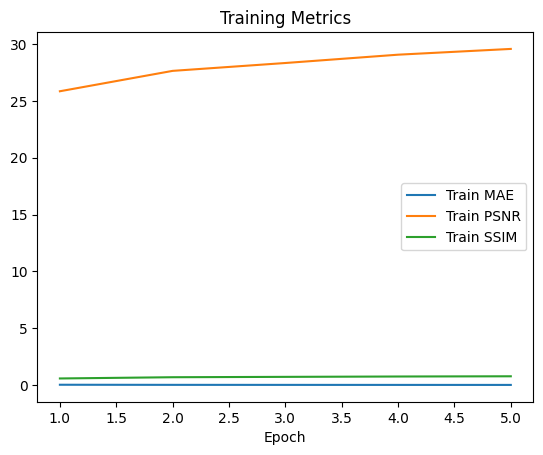

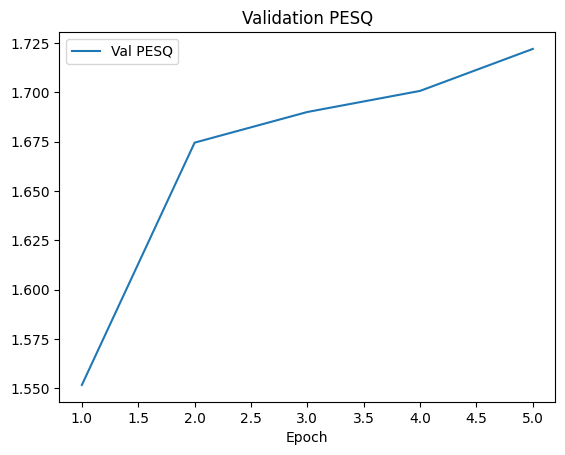

Training completed in 1719.92 seconds.


In [29]:
full_dataset = AudioDenoiseDataset(
    clean_folder=clean_dir,
    noise_folder=noise_dir,
    sample_rate=8000,
    frame_length=8064,
    hop_length_frame=8000,
    n_fft=255,
    hop_length_fft=63,
    nb_samples=20000,
    noise_levels=(0.2, 0.8),
)


num_total = len(full_dataset)
indices = np.arange(num_total)
np.random.shuffle(indices)

train_ratio = 0.8
num_train = int(train_ratio * num_total)
train_idx, val_idx = indices[:num_train], indices[num_train:]

train_dataset = Subset(full_dataset, train_idx)
val_dataset   = Subset(full_dataset, val_idx)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=4)
val_loader   = DataLoader(val_dataset,   batch_size=1,  shuffle=False, num_workers=2)


generator = TFDenseUNetGenerator()
discriminator = MultiScaleDiscriminator()

if torch.cuda.is_available() and torch.cuda.device_count() > 1:
    print(f"Using {torch.cuda.device_count()} GPUs with DataParallel")
    generator = nn.DataParallel(generator)
    discriminator = nn.DataParallel(discriminator)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator.to(device)
discriminator.to(device)


start_time = time.time()

history = train(
    generator, discriminator,
    train_dataset, val_dataset,
    num_epochs=5,
    batch_size=16,
    lr=1e-4,
    device=device,
    save_dir=SAVE_ROOT
)

end_time = time.time()

elapsed_time = end_time - start_time
print(f"Training completed in {elapsed_time:.2f} seconds.")

# 5000 data 50 epoch 16 batch size

Using 2 GPUs with DataParallel


Epoch 1/50: 100%|██████████| 250/250 [00:47<00:00,  5.29it/s, MAE=0.0454, PSNR=24.7, SSIM=0.476]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 1: current PESQ = 1.4990, best = -inf
Saved the best model


Epoch 2/50: 100%|██████████| 250/250 [00:47<00:00,  5.28it/s, MAE=0.0354, PSNR=25.6, SSIM=0.543]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 2: current PESQ = 1.5628, best = 1.4990
Saved the best model


Epoch 3/50: 100%|██████████| 250/250 [00:48<00:00,  5.20it/s, MAE=0.0318, PSNR=26, SSIM=0.569]  


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 3: current PESQ = 1.5678, best = 1.5628
Saved the best model


Epoch 4/50: 100%|██████████| 250/250 [00:47<00:00,  5.30it/s, MAE=0.0293, PSNR=26.7, SSIM=0.623]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 4: current PESQ = 1.6301, best = 1.5678
Saved the best model


Epoch 5/50: 100%|██████████| 250/250 [00:47<00:00,  5.27it/s, MAE=0.028, PSNR=27, SSIM=0.635]   


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 5: current PESQ = 1.6197, best = 1.6301


Epoch 6/50: 100%|██████████| 250/250 [00:47<00:00,  5.25it/s, MAE=0.0264, PSNR=27.1, SSIM=0.646]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 6: current PESQ = 1.5770, best = 1.6301


Epoch 7/50: 100%|██████████| 250/250 [00:47<00:00,  5.26it/s, MAE=0.0255, PSNR=28.2, SSIM=0.7]  


PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 7: current PESQ = 1.6247, best = 1.6301


Epoch 8/50: 100%|██████████| 250/250 [00:47<00:00,  5.29it/s, MAE=0.0245, PSNR=28, SSIM=0.688]  


PESQ computation failed for this sample
Epoch 8: current PESQ = 1.6922, best = 1.6301
Saved the best model


Epoch 9/50: 100%|██████████| 250/250 [00:47<00:00,  5.26it/s, MAE=0.024, PSNR=28.1, SSIM=0.689] 


PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 9: current PESQ = 1.5862, best = 1.6922


Epoch 10/50: 100%|██████████| 250/250 [00:46<00:00,  5.33it/s, MAE=0.0234, PSNR=28.3, SSIM=0.707]


PESQ computation failed for this sample
Epoch 10: current PESQ = 1.7058, best = 1.6922
Saved the best model


Epoch 11/50: 100%|██████████| 250/250 [00:47<00:00,  5.31it/s, MAE=0.0225, PSNR=28.2, SSIM=0.698]


PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 11: current PESQ = 1.6944, best = 1.7058


Epoch 12/50: 100%|██████████| 250/250 [00:47<00:00,  5.26it/s, MAE=0.0221, PSNR=28.5, SSIM=0.719]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 12: current PESQ = 1.6942, best = 1.7058


Epoch 13/50: 100%|██████████| 250/250 [00:47<00:00,  5.29it/s, MAE=0.0217, PSNR=28.4, SSIM=0.723]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 13: current PESQ = 1.6117, best = 1.7058


Epoch 14/50: 100%|██████████| 250/250 [00:47<00:00,  5.25it/s, MAE=0.0213, PSNR=28.8, SSIM=0.735]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 14: current PESQ = 1.6665, best = 1.7058


Epoch 15/50: 100%|██████████| 250/250 [00:47<00:00,  5.26it/s, MAE=0.0206, PSNR=28.6, SSIM=0.734]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 15: current PESQ = 1.6538, best = 1.7058


Epoch 16/50: 100%|██████████| 250/250 [00:47<00:00,  5.23it/s, MAE=0.0202, PSNR=29.3, SSIM=0.758]


PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 16: current PESQ = 1.6300, best = 1.7058


Epoch 17/50: 100%|██████████| 250/250 [00:48<00:00,  5.18it/s, MAE=0.0203, PSNR=29, SSIM=0.742]  


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 17: current PESQ = 1.6516, best = 1.7058


Epoch 18/50: 100%|██████████| 250/250 [00:47<00:00,  5.27it/s, MAE=0.0196, PSNR=29.9, SSIM=0.777]


PESQ computation failed for this sample
Epoch 18: current PESQ = 1.7311, best = 1.7058
Saved the best model


Epoch 19/50: 100%|██████████| 250/250 [00:48<00:00,  5.13it/s, MAE=0.0192, PSNR=29.9, SSIM=0.768]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 19: current PESQ = 1.7064, best = 1.7311


Epoch 20/50: 100%|██████████| 250/250 [00:47<00:00,  5.22it/s, MAE=0.0194, PSNR=29.2, SSIM=0.751]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 20: current PESQ = 1.6559, best = 1.7311


Epoch 21/50: 100%|██████████| 250/250 [00:47<00:00,  5.26it/s, MAE=0.0188, PSNR=29.9, SSIM=0.788]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 21: current PESQ = 1.7124, best = 1.7311


Epoch 22/50: 100%|██████████| 250/250 [00:47<00:00,  5.24it/s, MAE=0.0188, PSNR=29.6, SSIM=0.772]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 22: current PESQ = 1.7222, best = 1.7311


Epoch 23/50: 100%|██████████| 250/250 [00:47<00:00,  5.29it/s, MAE=0.0184, PSNR=29.1, SSIM=0.766]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 23: current PESQ = 1.7237, best = 1.7311


Epoch 24/50: 100%|██████████| 250/250 [00:46<00:00,  5.33it/s, MAE=0.0176, PSNR=30.2, SSIM=0.78] 


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 24: current PESQ = 1.7541, best = 1.7311
Saved the best model


Epoch 25/50: 100%|██████████| 250/250 [00:46<00:00,  5.32it/s, MAE=0.0181, PSNR=29.6, SSIM=0.768]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 25: current PESQ = 1.7180, best = 1.7541


Epoch 26/50: 100%|██████████| 250/250 [00:47<00:00,  5.23it/s, MAE=0.0175, PSNR=30.4, SSIM=0.801]


PESQ computation failed for this sample
Epoch 26: current PESQ = 1.7302, best = 1.7541


Epoch 27/50: 100%|██████████| 250/250 [00:46<00:00,  5.32it/s, MAE=0.0171, PSNR=30.5, SSIM=0.789]


Epoch 27: current PESQ = 1.7695, best = 1.7541
Saved the best model


Epoch 28/50: 100%|██████████| 250/250 [00:47<00:00,  5.28it/s, MAE=0.0169, PSNR=30.6, SSIM=0.8]  


PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 28: current PESQ = 1.7456, best = 1.7695


Epoch 29/50: 100%|██████████| 250/250 [00:46<00:00,  5.32it/s, MAE=0.0169, PSNR=30.1, SSIM=0.783]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 29: current PESQ = 1.7197, best = 1.7695


Epoch 30/50: 100%|██████████| 250/250 [00:47<00:00,  5.32it/s, MAE=0.0168, PSNR=30.6, SSIM=0.814]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 30: current PESQ = 1.7354, best = 1.7695


Epoch 31/50: 100%|██████████| 250/250 [00:46<00:00,  5.35it/s, MAE=0.0163, PSNR=31.7, SSIM=0.827]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 31: current PESQ = 1.6848, best = 1.7695


Epoch 32/50: 100%|██████████| 250/250 [00:47<00:00,  5.30it/s, MAE=0.0165, PSNR=30.5, SSIM=0.8]  


PESQ computation failed for this sample
Epoch 32: current PESQ = 1.7350, best = 1.7695


Epoch 33/50: 100%|██████████| 250/250 [00:47<00:00,  5.31it/s, MAE=0.0159, PSNR=31, SSIM=0.799]  


PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 33: current PESQ = 1.7373, best = 1.7695


Epoch 34/50: 100%|██████████| 250/250 [00:47<00:00,  5.32it/s, MAE=0.0157, PSNR=31.2, SSIM=0.823]


PESQ computation failed for this sample
Epoch 34: current PESQ = 1.7598, best = 1.7695


Epoch 35/50: 100%|██████████| 250/250 [00:47<00:00,  5.32it/s, MAE=0.016, PSNR=30.5, SSIM=0.799] 


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 35: current PESQ = 1.7378, best = 1.7695


Epoch 36/50: 100%|██████████| 250/250 [00:46<00:00,  5.33it/s, MAE=0.0152, PSNR=31, SSIM=0.822]  


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 36: current PESQ = 1.7708, best = 1.7695
Saved the best model


Epoch 37/50: 100%|██████████| 250/250 [00:47<00:00,  5.26it/s, MAE=0.0157, PSNR=30.6, SSIM=0.805]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 37: current PESQ = 1.8254, best = 1.7708
Saved the best model


Epoch 38/50: 100%|██████████| 250/250 [00:47<00:00,  5.29it/s, MAE=0.0152, PSNR=31.2, SSIM=0.82] 


PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 38: current PESQ = 1.7570, best = 1.8254


Epoch 39/50: 100%|██████████| 250/250 [00:47<00:00,  5.23it/s, MAE=0.0153, PSNR=31.3, SSIM=0.825]


PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 39: current PESQ = 1.7842, best = 1.8254


Epoch 40/50: 100%|██████████| 250/250 [00:47<00:00,  5.29it/s, MAE=0.0148, PSNR=31.4, SSIM=0.827]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 40: current PESQ = 1.7450, best = 1.8254


Epoch 41/50: 100%|██████████| 250/250 [00:46<00:00,  5.32it/s, MAE=0.0145, PSNR=31.9, SSIM=0.835]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 41: current PESQ = 1.7176, best = 1.8254


Epoch 42/50: 100%|██████████| 250/250 [00:47<00:00,  5.29it/s, MAE=0.0148, PSNR=31.2, SSIM=0.828]


PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 42: current PESQ = 1.8070, best = 1.8254


Epoch 43/50: 100%|██████████| 250/250 [00:47<00:00,  5.29it/s, MAE=0.0145, PSNR=31.4, SSIM=0.817]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 43: current PESQ = 1.7377, best = 1.8254


Epoch 44/50: 100%|██████████| 250/250 [00:46<00:00,  5.32it/s, MAE=0.0145, PSNR=31.9, SSIM=0.838]


PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 44: current PESQ = 1.7581, best = 1.8254


Epoch 45/50: 100%|██████████| 250/250 [00:46<00:00,  5.33it/s, MAE=0.0142, PSNR=32.4, SSIM=0.844]


PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 45: current PESQ = 1.7548, best = 1.8254


Epoch 46/50: 100%|██████████| 250/250 [00:48<00:00,  5.20it/s, MAE=0.0144, PSNR=31.5, SSIM=0.835]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 46: current PESQ = 1.7891, best = 1.8254


Epoch 47/50: 100%|██████████| 250/250 [00:46<00:00,  5.32it/s, MAE=0.0144, PSNR=31.9, SSIM=0.845]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 47: current PESQ = 1.7633, best = 1.8254


Epoch 48/50: 100%|██████████| 250/250 [00:46<00:00,  5.32it/s, MAE=0.014, PSNR=32.3, SSIM=0.842] 


PESQ computation failed for this sample
Epoch 48: current PESQ = 1.7754, best = 1.8254


Epoch 49/50: 100%|██████████| 250/250 [00:47<00:00,  5.30it/s, MAE=0.0139, PSNR=32.4, SSIM=0.846]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 49: current PESQ = 1.7656, best = 1.8254


Epoch 50/50: 100%|██████████| 250/250 [00:47<00:00,  5.24it/s, MAE=0.0139, PSNR=32.5, SSIM=0.861]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
Epoch 50: current PESQ = 1.7956, best = 1.8254


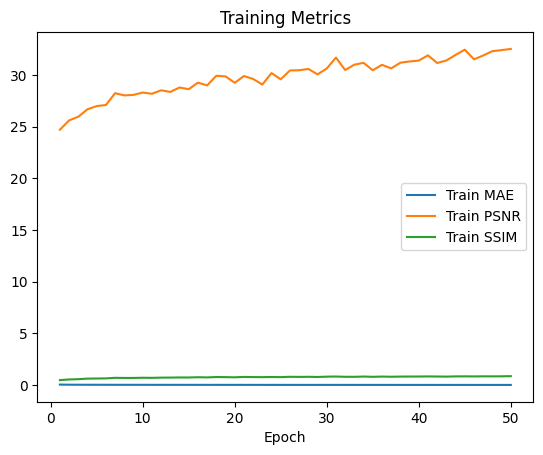

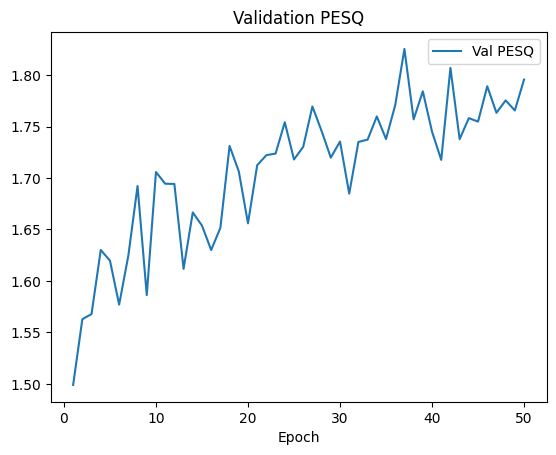

Training completed in 4332.09 seconds.


In [33]:
full_dataset = AudioDenoiseDataset(
    clean_folder=clean_dir,
    noise_folder=noise_dir,
    sample_rate=8000,
    frame_length=8064,
    hop_length_frame=8000,
    n_fft=255,
    hop_length_fft=63,
    nb_samples=5000,
    noise_levels=(0.2, 0.8),
)


num_total = len(full_dataset)
indices = np.arange(num_total)
np.random.shuffle(indices)

train_ratio = 0.8
num_train = int(train_ratio * num_total)
train_idx, val_idx = indices[:num_train], indices[num_train:]

train_dataset = Subset(full_dataset, train_idx)
val_dataset   = Subset(full_dataset, val_idx)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=4)
val_loader   = DataLoader(val_dataset,   batch_size=1,  shuffle=False, num_workers=2)


generator = TFDenseUNetGenerator()
discriminator = MultiScaleDiscriminator()

if torch.cuda.is_available() and torch.cuda.device_count() > 1:
    print(f"Using {torch.cuda.device_count()} GPUs with DataParallel")
    generator = nn.DataParallel(generator)
    discriminator = nn.DataParallel(discriminator)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator.to(device)
discriminator.to(device)


start_time = time.time()

history = train(
    generator, discriminator,
    train_dataset, val_dataset,
    num_epochs=50,
    batch_size=16,
    lr=1e-4,
    device=device,
    save_dir=SAVE_ROOT
)

end_time = time.time()

elapsed_time = end_time - start_time
print(f"Training completed in {elapsed_time:.2f} seconds.")

# 100 000 data, 3 epochs, 16 batch size

In [ ]:
from torch.utils.data import Subset, DataLoader
import numpy as np
import torch
import torch.nn as nn
import time

full_dataset = AudioDenoiseDataset(
    clean_folder=clean_dir,
    noise_folder=noise_dir,
    sample_rate=8000,
    frame_length=8064,
    hop_length_frame=8000,
    n_fft=255,
    hop_length_fft=63,
    nb_samples=100000,
    noise_levels=(0.2, 0.8),
)


num_total = len(full_dataset)
indices = np.arange(num_total)
np.random.shuffle(indices)

train_ratio = 0.8
num_train = int(train_ratio * num_total)
train_idx, val_idx = indices[:num_train], indices[num_train:]

train_dataset = Subset(full_dataset, train_idx)
val_dataset   = Subset(full_dataset, val_idx)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=4)
val_loader   = DataLoader(val_dataset,   batch_size=1,  shuffle=False, num_workers=2)


generator = TFDenseUNetGenerator()
discriminator = MultiScaleDiscriminator()

if torch.cuda.is_available() and torch.cuda.device_count() > 1:
    print(f"Using {torch.cuda.device_count()} GPUs with DataParallel")
    generator = nn.DataParallel(generator)
    discriminator = nn.DataParallel(discriminator)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator.to(device)
discriminator.to(device)


start_time = time.time()

history = train(
    generator, discriminator,
    train_dataset, val_dataset,
    num_epochs=3,
    batch_size=16,
    lr=1e-4,
    device=device,
    save_dir=SAVE_ROOT
)

end_time = time.time()

elapsed_time = end_time - start_time
print(f"Training completed in {elapsed_time:.2f} seconds.")

Using 2 GPUs with DataParallel


Epoch 1/3: 100%|██████████| 5000/5000 [17:19<00:00,  4.81it/s, MAE=0.0236, PSNR=28.3, SSIM=0.717]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 2/3:  91%|█████████ | 4533/5000 [15:44<01:35,  4.90it/s, MAE=0.016, PSNR=30.9, SSIM=0.814] 

PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


### Single GPU Training.

In [30]:
SAVE_ROOT = "/kaggle/working/checkpoints"
print("Saved files:", os.listdir(SAVE_ROOT))
!zip -r /kaggle/working/checkpoints.zip {SAVE_ROOT}
print("Zipped:", os.path.exists("/kaggle/working/checkpoints.zip"))

Saved files: ['best_model.pth', 'best_history.json']
  adding: kaggle/working/checkpoints/ (stored 0%)
  adding: kaggle/working/checkpoints/best_model.pth (deflated 8%)
  adding: kaggle/working/checkpoints/best_history.json (deflated 46%)
Zipped: True


In [23]:
from torch.utils.data import Subset, DataLoader
import numpy as np
import torch
import torch.nn as nn
import time

full_dataset = AudioDenoiseDataset(
    clean_folder=clean_dir,
    noise_folder=noise_dir,
    sample_rate=8000,
    frame_length=8064,
    hop_length_frame=8000,
    n_fft=255,
    hop_length_fft=63,
    nb_samples=100000,
    noise_levels=(0.2, 0.8),
)


num_total = len(full_dataset)
indices = np.arange(num_total)
np.random.shuffle(indices)

train_ratio = 0.8
num_train = int(train_ratio * num_total)
train_idx, val_idx = indices[:num_train], indices[num_train:]

train_dataset = Subset(full_dataset, train_idx)
val_dataset   = Subset(full_dataset, val_idx)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=4)
val_loader   = DataLoader(val_dataset,   batch_size=1,  shuffle=False, num_workers=2)

generator_single = TFDenseUNetGenerator()
discriminator_single = MultiScaleDiscriminator()

device = "cuda" if torch.cuda.is_available() else "cpu"
generator_single.to(device)
discriminator_single.to(device)

start_time = time.time()

history = train(
    generator_single, discriminator_single,
    train_dataset, val_dataset,
    num_epochs=50,
    batch_size=16,
    lr=1e-4,
    device=device,
    save_dir="/kaggle/working/checkpoints"
)

end_time = time.time()

elapsed_time = end_time - start_time
print(f"Training completed in {elapsed_time:.2f} seconds.")

Epoch 1/50:   1%|▏         | 74/5000 [00:17<19:33,  4.20it/s, MAE=0.0507, PSNR=25.5, SSIM=0.491] 


KeyboardInterrupt: 

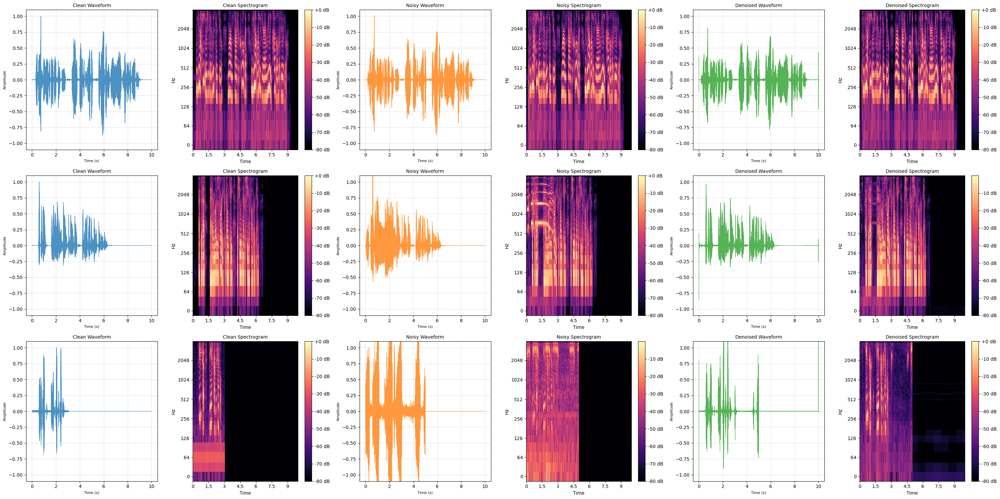


Sample 1 Results:
 PESQ Score: 3.70
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 2 Results:
 PESQ Score: 3.33
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 3 Results:
 PESQ Score: 1.81
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===


In [27]:
def visualize_denoising_sample(model, dataset, device, num_samples=3, duration=10):
    model.eval()
    sr = dataset.sr
    n_fft = dataset.n_fft
    hop_fft = dataset.hop_fft
    target_len = int(duration * sr)

    fig, axs = plt.subplots(num_samples, 6, figsize=(30, num_samples*5))
    
    results = []
    
    for i in range(num_samples):
        clean_path = random.choice(dataset.clean_files)
        noise_path = random.choice(dataset.noise_files)
        
        clean, _ = librosa.load(clean_path, sr=sr)
        clean = clean[:target_len] if len(clean) >= target_len else np.pad(clean, (0, target_len - len(clean)))
        
        noise, _ = librosa.load(noise_path, sr=sr)
        noise = noise[:target_len] if len(noise) >= target_len else np.pad(noise, (0, target_len - len(noise)))
        
        level = np.random.uniform(*dataset.noise_levels)
        noisy = clean + level * noise

        S_clean = librosa.stft(clean, n_fft=n_fft, hop_length=hop_fft, center=False)
        S_noisy = librosa.stft(noisy, n_fft=n_fft, hop_length=hop_fft, center=False)
        phase = np.angle(S_noisy)
        
        with torch.no_grad():
            mag_noisy = np.abs(S_noisy)
            log_mag = np.log1p(mag_noisy)
            max_val = np.max(np.abs(log_mag)) + 1e-9
            log_mag_norm = log_mag / max_val
            
            F, T = log_mag_norm.shape
            log_mag_padded = pad_to_multiple(log_mag_norm, mult=8)
            
            input_tensor = torch.from_numpy(log_mag_padded).unsqueeze(0).unsqueeze(0).float().to(device)
            
            output = model(input_tensor)
            
            denoised_log_norm = output.squeeze().cpu().numpy()
            denoised_log = denoised_log_norm * max_val
            mag_denoised = np.exp(denoised_log) - 1
            
            mag_denoised = mag_denoised[:F, :T]
        
        denoised_stft = mag_denoised * np.exp(1j * phase)
        denoised = librosa.istft(denoised_stft, hop_length=hop_fft, center=False)
        denoised = np.pad(denoised, (0, target_len - len(denoised)))[:target_len]

        try:
            pesq_score = pesq(sr, clean, denoised, 'nb')
        except Exception as e:
            pesq_score = None
            print(f"PESQ calculation failed for sample {i+1}: {str(e)}")

        results.append({
            'clean': clean,
            'noisy': noisy,
            'denoised': denoised,
            'pesq': pesq_score
        })

        time = np.linspace(0, duration, target_len)
        max_clean = np.max(np.abs(clean)) + 1e-9
        colors = ['#1f77b4', '#ff7f0e', '#2ca02c']
        
        for j, (sig, title) in enumerate(zip(
            [clean, noisy, denoised],
            ["Clean", "Noisy", "Denoised"]
        )):
            ax = axs[i, j*2]
            ax.plot(time, sig/max_clean, 
                   color=colors[j],
                   linewidth=0.8,
                   alpha=0.8)
            ax.set_ylim(-1.1, 1.1)
            ax.set_xlabel('Time (s)', fontsize=8)
            ax.set_ylabel('Amplitude', fontsize=8)
            ax.set_title(f"{title} Waveform", fontsize=10)
            ax.grid(True, linestyle='--', alpha=0.5)
            
            ax = axs[i, j*2+1]
            S = librosa.amplitude_to_db(np.abs(librosa.stft(sig, n_fft=n_fft)), 
                                      ref=np.max)
            img = librosa.display.specshow(S, 
                                         sr=sr, 
                                         hop_length=hop_fft,
                                         x_axis='time', 
                                         y_axis='log',
                                         ax=ax,
                                         cmap='magma')
            ax.set_title(f"{title} Spectrogram", fontsize=10)
            fig.colorbar(img, ax=ax, format='%+2.0f dB')

    plt.tight_layout()
    plt.savefig("100 000 data, 5 epochs 16 bs.png", dpi=300) 
    plt.show()
    
    for idx, result in enumerate(results):
        max_audio = np.max(np.abs(result['clean']))
        print(f"\nSample {idx+1} Results:")
        if result['pesq'] is not None:
            print(f" PESQ Score: {result['pesq']:.2f}")
        
        for key in ['clean', 'noisy', 'denoised']:
            print(f"=== {key.capitalize()} Audio ===")
            display(Audio(result[key]/max_audio, rate=sr))


dataset = AudioDenoiseDataset(
    clean_folder=clean_dir,
    noise_folder=noise_dir,
    sample_rate=8000,
    frame_length=8064,
    hop_length_frame=8000,
    n_fft=255,
    hop_length_fft=63,
    nb_samples=50,
    noise_levels=(0.2, 0.8),
)

visualize_denoising_sample(generator, dataset, device, num_samples=3, duration=10)

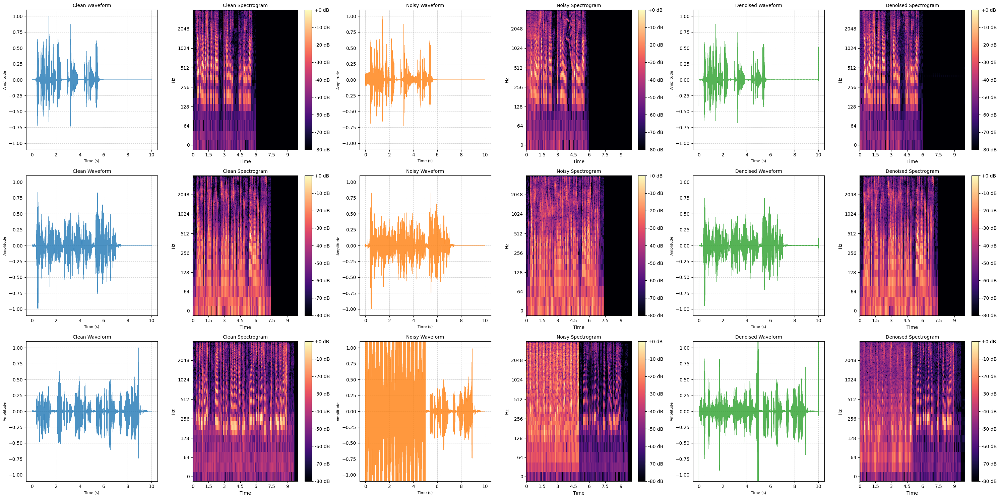


Sample 1 Results:
 PESQ Score: 3.27
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 2 Results:
 PESQ Score: 2.86
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 3 Results:
 PESQ Score: 1.59
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===


In [35]:
visualize_denoising_sample(generator, dataset, device, num_samples=3, duration=10)

# 100 000 data 5 epochs 16 batch size:

Using 2 GPUs with DataParallel


Epoch 1/5: 100%|██████████| 5000/5000 [17:12<00:00,  4.84it/s, MAE=0.0232, PSNR=28.5, SSIM=0.718]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 2/5: 100%|██████████| 5000/5000 [16:22<00:00,  5.09it/s, MAE=0.0156, PSNR=31.1, SSIM=0.818]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 3/5: 100%|██████████| 5000/5000 [16:26<00:00,  5.07it/s, MAE=0.0132, PSNR=32.6, SSIM=0.848]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 4/5: 100%|██████████| 5000/5000 [16:27<00:00,  5.06it/s, MAE=0.0119, PSNR=33.4, SSIM=0.859]


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


Epoch 5/5: 100%|██████████| 5000/5000 [16:26<00:00,  5.07it/s, MAE=0.0112, PSNR=34.2, SSIM=0.87] 


PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample
PESQ computation failed for this sample


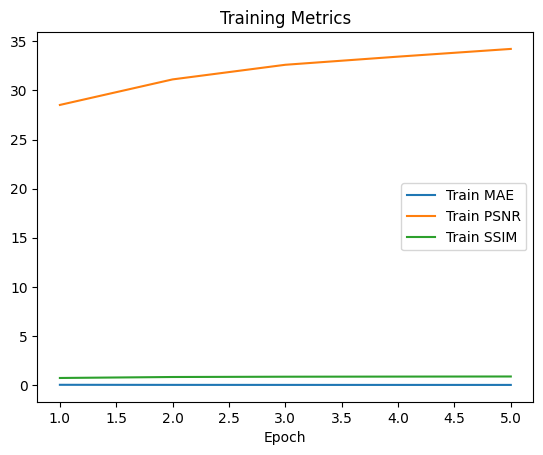

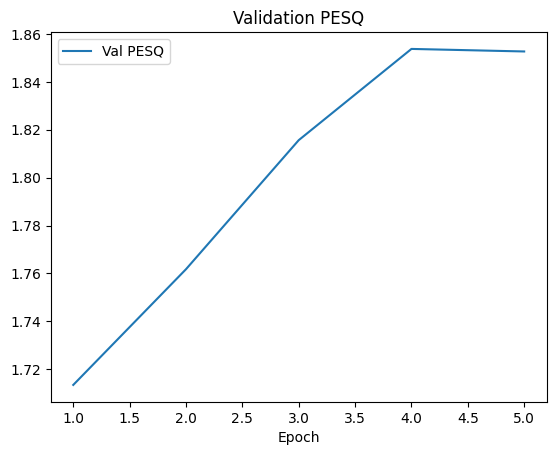

Training completed in 9033.90 seconds.


In [32]:
full_dataset = AudioDenoiseDataset(
    clean_folder=clean_dir,
    noise_folder=noise_dir,
    sample_rate=8000,
    frame_length=8064,
    hop_length_frame=8000,
    n_fft=255,
    hop_length_fft=63,
    nb_samples=100000,
    noise_levels=(0.2, 0.8),
)


num_total = len(full_dataset)
indices = np.arange(num_total)
np.random.shuffle(indices)

train_ratio = 0.8
num_train = int(train_ratio * num_total)
train_idx, val_idx = indices[:num_train], indices[num_train:]

train_dataset = Subset(full_dataset, train_idx)
val_dataset   = Subset(full_dataset, val_idx)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=4)
val_loader   = DataLoader(val_dataset,   batch_size=1,  shuffle=False, num_workers=2)


generator = TFDenseUNetGenerator()
discriminator = MultiScaleDiscriminator()

if torch.cuda.is_available() and torch.cuda.device_count() > 1:
    print(f"Using {torch.cuda.device_count()} GPUs with DataParallel")
    generator = nn.DataParallel(generator)
    discriminator = nn.DataParallel(discriminator)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator.to(device)
discriminator.to(device)


start_time = time.time()

history = train(
    generator, discriminator,
    train_dataset, val_dataset,
    num_epochs=5,
    batch_size=16,
    lr=1e-4,
    device=device,
    save_dir=SAVE_ROOT
)

end_time = time.time()

elapsed_time = end_time - start_time
print(f"Training completed in {elapsed_time:.2f} seconds.")

In [33]:
SAVE_ROOT = "/kaggle/working/checkpoints"
print("Saved files:", os.listdir(SAVE_ROOT))
!zip -r /kaggle/working/checkpoints.zip {SAVE_ROOT}
print("Zipped:", os.path.exists("/kaggle/working/checkpoints.zip"))

Saved files: ['best_model.pth', 'best_history.json']
updating: kaggle/working/checkpoints/ (stored 0%)
updating: kaggle/working/checkpoints/best_model.pth (deflated 8%)
updating: kaggle/working/checkpoints/best_history.json (deflated 49%)
Zipped: True


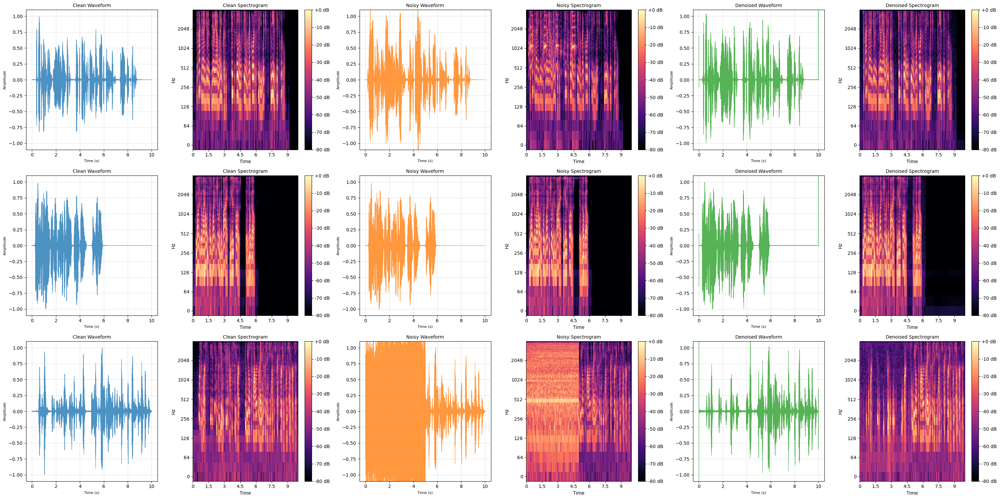


Sample 1 Results:
 PESQ Score: 3.31
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 2 Results:
 PESQ Score: 4.20
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 3 Results:
 PESQ Score: 1.99
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===


In [26]:
def visualize_denoising_sample(model, dataset, device, num_samples=3, duration=10):
    model.eval()
    sr = dataset.sr
    n_fft = dataset.n_fft
    hop_fft = dataset.hop_fft
    target_len = int(duration * sr)

    fig, axs = plt.subplots(num_samples, 6, figsize=(30, num_samples*5))
    
    results = []
    
    for i in range(num_samples):
        clean_path = random.choice(dataset.clean_files)
        noise_path = random.choice(dataset.noise_files)
        
        clean, _ = librosa.load(clean_path, sr=sr)
        clean = clean[:target_len] if len(clean) >= target_len else np.pad(clean, (0, target_len - len(clean)))
        
        noise, _ = librosa.load(noise_path, sr=sr)
        noise = noise[:target_len] if len(noise) >= target_len else np.pad(noise, (0, target_len - len(noise)))
        
        level = np.random.uniform(*dataset.noise_levels)
        noisy = clean + level * noise

        S_clean = librosa.stft(clean, n_fft=n_fft, hop_length=hop_fft, center=False)
        S_noisy = librosa.stft(noisy, n_fft=n_fft, hop_length=hop_fft, center=False)
        phase = np.angle(S_noisy)
        
        with torch.no_grad():
            mag_noisy = np.abs(S_noisy)
            log_mag = np.log1p(mag_noisy)
            max_val = np.max(np.abs(log_mag)) + 1e-9
            log_mag_norm = log_mag / max_val
            
            F, T = log_mag_norm.shape
            log_mag_padded = pad_to_multiple(log_mag_norm, mult=8)
            
            input_tensor = torch.from_numpy(log_mag_padded).unsqueeze(0).unsqueeze(0).float().to(device)
            
            output = model(input_tensor)
            
            denoised_log_norm = output.squeeze().cpu().numpy()
            denoised_log = denoised_log_norm * max_val
            mag_denoised = np.exp(denoised_log) - 1
            
            mag_denoised = mag_denoised[:F, :T]
        
        denoised_stft = mag_denoised * np.exp(1j * phase)
        denoised = librosa.istft(denoised_stft, hop_length=hop_fft, center=False)
        denoised = np.pad(denoised, (0, target_len - len(denoised)))[:target_len]

        try:
            pesq_score = pesq(sr, clean, denoised, 'nb')
        except Exception as e:
            pesq_score = None
            print(f"PESQ calculation failed for sample {i+1}: {str(e)}")

        results.append({
            'clean': clean,
            'noisy': noisy,
            'denoised': denoised,
            'pesq': pesq_score
        })

        time = np.linspace(0, duration, target_len)
        max_clean = np.max(np.abs(clean)) + 1e-9
        colors = ['#1f77b4', '#ff7f0e', '#2ca02c']
        
        for j, (sig, title) in enumerate(zip(
            [clean, noisy, denoised],
            ["Clean", "Noisy", "Denoised"]
        )):
            ax = axs[i, j*2]
            ax.plot(time, sig/max_clean, 
                   color=colors[j],
                   linewidth=0.8,
                   alpha=0.8)
            ax.set_ylim(-1.1, 1.1)
            ax.set_xlabel('Time (s)', fontsize=8)
            ax.set_ylabel('Amplitude', fontsize=8)
            ax.set_title(f"{title} Waveform", fontsize=10)
            ax.grid(True, linestyle='--', alpha=0.5)
            
            ax = axs[i, j*2+1]
            S = librosa.amplitude_to_db(np.abs(librosa.stft(sig, n_fft=n_fft)), 
                                      ref=np.max)
            img = librosa.display.specshow(S, 
                                         sr=sr, 
                                         hop_length=hop_fft,
                                         x_axis='time', 
                                         y_axis='log',
                                         ax=ax,
                                         cmap='magma')
            ax.set_title(f"{title} Spectrogram", fontsize=10)
            fig.colorbar(img, ax=ax, format='%+2.0f dB')

    plt.tight_layout()
    plt.savefig("50 000 data, 10 epochs 16 bs.png", dpi=300) 
    plt.show()
    
    for idx, result in enumerate(results):
        max_audio = np.max(np.abs(result['clean']))
        print(f"\nSample {idx+1} Results:")
        if result['pesq'] is not None:
            print(f" PESQ Score: {result['pesq']:.2f}")
        
        for key in ['clean', 'noisy', 'denoised']:
            print(f"=== {key.capitalize()} Audio ===")
            display(Audio(result[key]/max_audio, rate=sr))
            
dataset = AudioDenoiseDataset(
    clean_folder=clean_dir,
    noise_folder=noise_dir,
    sample_rate=8000,
    frame_length=8064,
    hop_length_frame=8000,
    n_fft=255,
    hop_length_fft=63,
    nb_samples=50,
    noise_levels=(0.2, 0.5),
)

visualize_denoising_sample(generator, dataset, device, num_samples=3, duration=10)

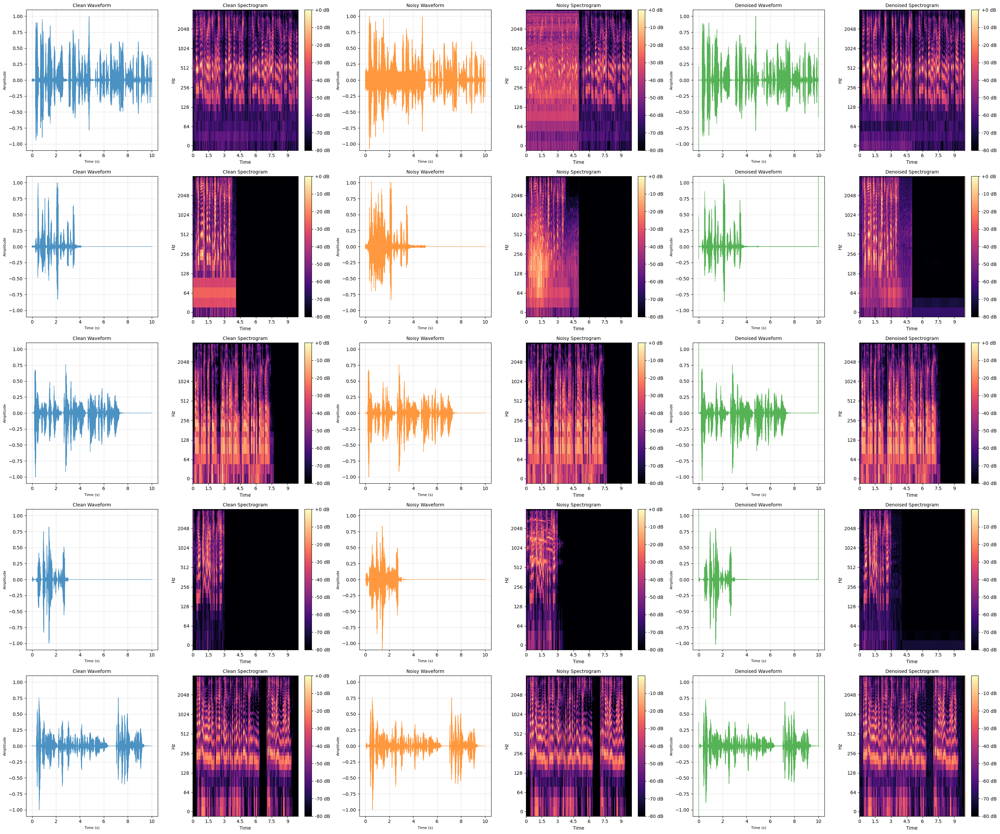


Sample 1 Results:
 PESQ Score: 3.36
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 2 Results:
 PESQ Score: 2.63
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 3 Results:
 PESQ Score: 3.50
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 4 Results:
 PESQ Score: 3.06
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 5 Results:
 PESQ Score: 3.82
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===


In [33]:
dataset = AudioDenoiseDataset(
    clean_folder=clean_dir,
    noise_folder=noise_dir,
    sample_rate=8000,
    frame_length=8064,
    hop_length_frame=8000,
    n_fft=255,
    hop_length_fft=63,
    nb_samples=500,
    noise_levels=(0.2, 0.4),
)

visualize_denoising_sample(generator, dataset, device, num_samples=5, duration=10)

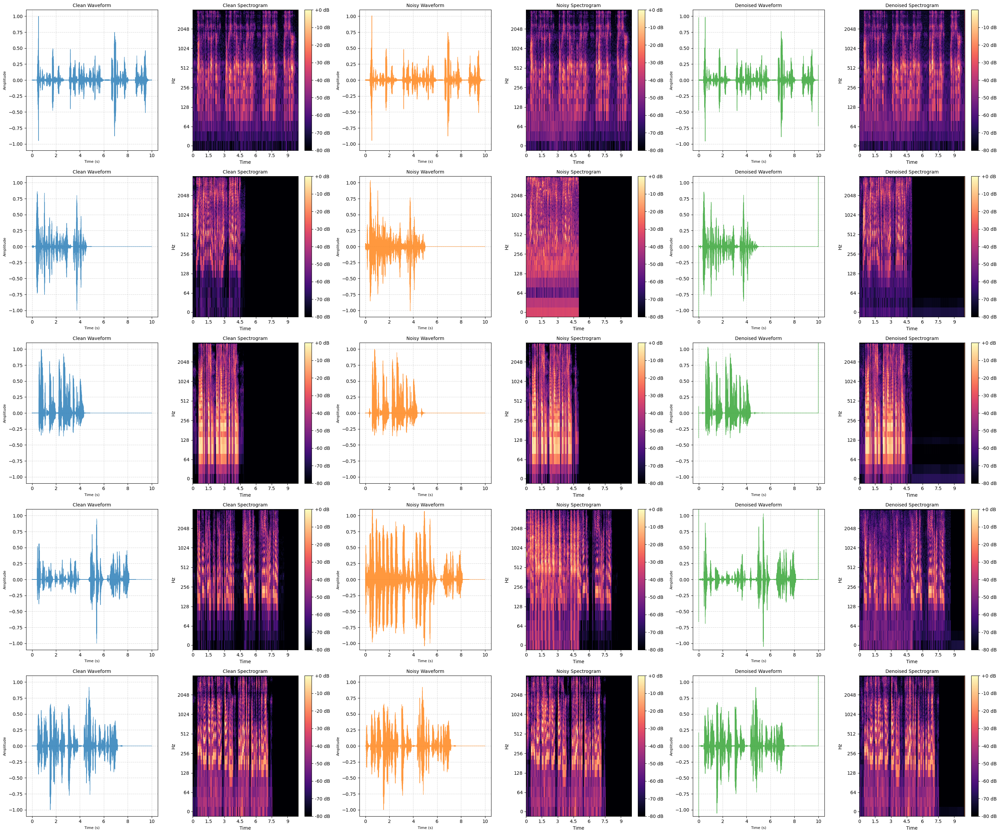


Sample 1 Results:
 PESQ Score: 3.91
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 2 Results:
 PESQ Score: 2.80
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 3 Results:
 PESQ Score: 3.56
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 4 Results:
 PESQ Score: 2.06
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 5 Results:
 PESQ Score: 3.76
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===


In [34]:
dataset = AudioDenoiseDataset(
    clean_folder=clean_dir,
    noise_folder=noise_dir,
    sample_rate=8000,
    frame_length=8064,
    hop_length_frame=8000,
    n_fft=255,
    hop_length_fft=63,
    nb_samples=500,
    noise_levels=(0.2, 0.4),
)

visualize_denoising_sample(generator, dataset, device, num_samples=5, duration=10)

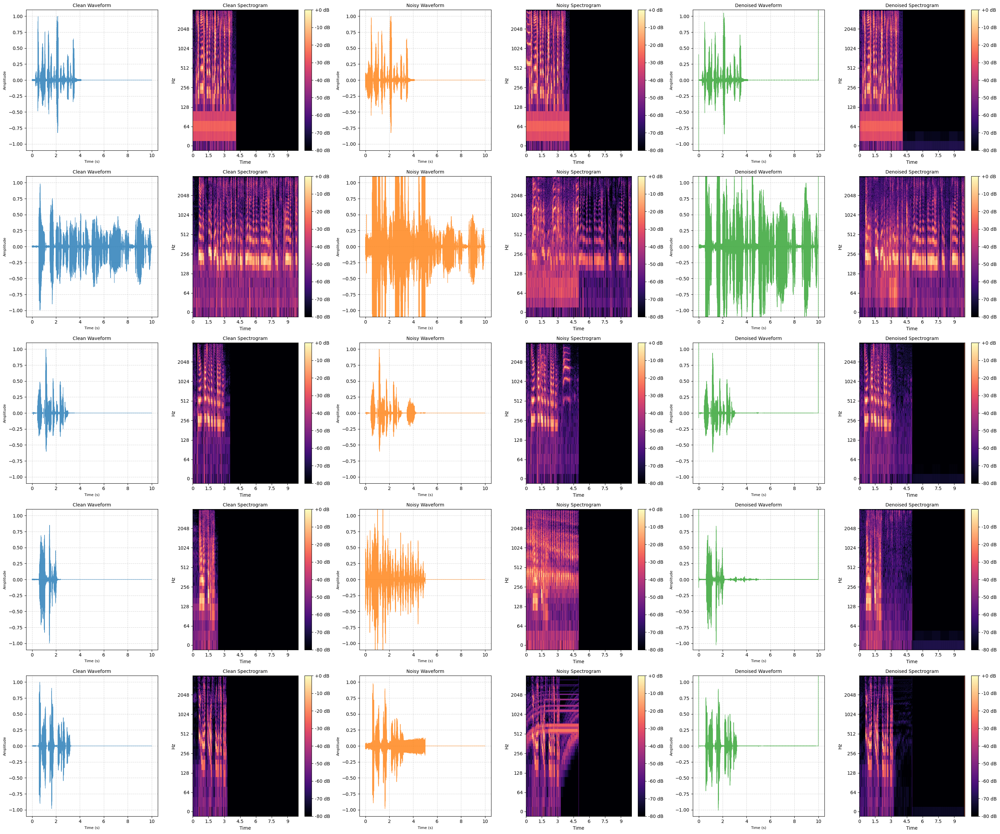


Sample 1 Results:
 PESQ Score: 4.27
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 2 Results:
 PESQ Score: 1.76
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 3 Results:
 PESQ Score: 3.46
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 4 Results:
 PESQ Score: 1.94
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 5 Results:
 PESQ Score: 3.27
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===


In [35]:
dataset = AudioDenoiseDataset(
    clean_folder=clean_dir,
    noise_folder=noise_dir,
    sample_rate=8000,
    frame_length=8064,
    hop_length_frame=8000,
    n_fft=255,
    hop_length_fft=63,
    nb_samples=500,
    noise_levels=(0.2, 0.4),
)

visualize_denoising_sample(generator, dataset, device, num_samples=5, duration=10)

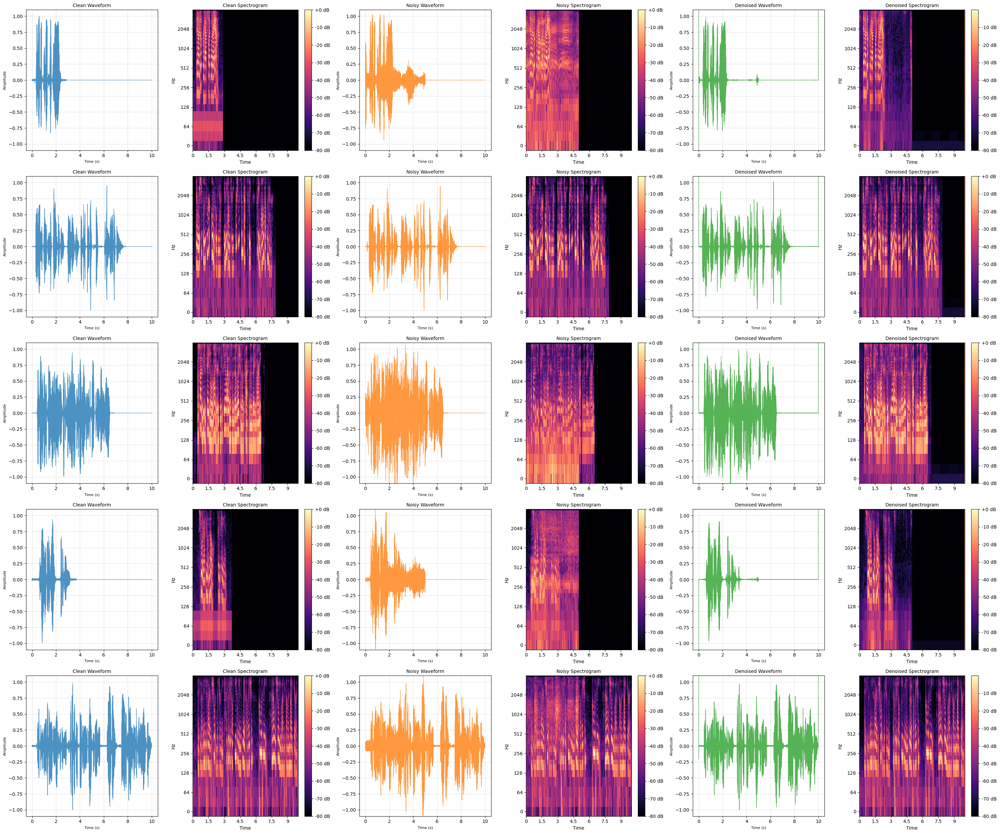


Sample 1 Results:
 PESQ Score: 2.92
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 2 Results:
 PESQ Score: 4.17
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 3 Results:
 PESQ Score: 3.36
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 4 Results:
 PESQ Score: 2.56
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===



Sample 5 Results:
 PESQ Score: 3.02
=== Clean Audio ===


=== Noisy Audio ===


=== Denoised Audio ===


In [37]:
dataset = AudioDenoiseDataset(
    clean_folder=clean_dir,
    noise_folder=noise_dir,
    sample_rate=8000,
    frame_length=8064,
    hop_length_frame=8000,
    n_fft=255,
    hop_length_fft=63,
    nb_samples=500,
    noise_levels=(0.2, 0.8),
)

visualize_denoising_sample(generator, dataset, device, num_samples=5, duration=10)